In [1]:
import glob
from PIL import Image
import numpy as np
from scipy import signal
from matplotlib import cm
from IPython.display import display

In [2]:
# Parameters

z_r = 17.0
z_a = 6.5
z_b = 15.0

z_f_list = 14.6 + np.arange(4) * 0.4

pupil_diameter = 5.0

size_r = 5.5
size_a = size_r * z_a / z_r
size_b = size_r * z_b / z_r

res_r = 1024
low_res_a = 8
low_res_b = 128
high_res_a = 17
high_res_b = 1024

In [3]:
# Basic coordinate manipulation functions

def compute_coordinates(res, size):
    """Return an array of shape (res) containing the coordinates of a sampling lattice."""
    pitch = size / res
    indices = np.arange(res)
    return (indices - (res - 1)/2) * pitch

def compute_intervals(res, size):
    """Return an array of shape (res, 2) containing the boundaries of each sampling region."""
    pitch = size / res
    indices = np.arange(res)
    lower_boundaries = indices * pitch - size/2
    upper_boundaries = lower_boundaries + pitch
    return np.stack([lower_boundaries, upper_boundaries], axis=-1)

def compute_intervals_at_pupil(res_r, res_a, res_b, z_r, z_a, z_b, z_f, size_r, size_a, size_b, pupil_diameter):
    """Project the 1-dim intervals of both display planes to the pupil plane and return their intersections."""
    # Compute retina coordinates and display intervals with shape (idx_r, idx_a, idx_b, Lower|Upper)
    coordinates_r = compute_coordinates(res_r, size_r)[    ::    , np.newaxis, np.newaxis, np.newaxis]
    intervals_a   =   compute_intervals(res_a, size_a)[np.newaxis,     ::    , np.newaxis,     ::    ]
    intervals_b   =   compute_intervals(res_b, size_b)[np.newaxis, np.newaxis,     ::    ,     ::    ]

    # Project intervals to the pupil plane
    projected_a = (intervals_a - coordinates_r * z_a/z_r) * np.nan_to_num(1.0 / (1.0 - z_a/z_f), nan=np.inf)
    projected_b = (intervals_b - coordinates_r * z_b/z_r) * np.nan_to_num(1.0 / (1.0 - z_b/z_f), nan=np.inf)

    # Swap lower and upper boundaries if focus distance is less than panel distance since the projection gets inverted
    projected_a = projected_a if z_f >= z_a else np.flip(projected_a, axis=-1)
    projected_b = projected_b if z_f >= z_b else np.flip(projected_b, axis=-1)

    # Intersect the pupil interval, plane A projected intervals and plane B projected intervals
    intersection = np.array([-pupil_diameter/2, pupil_diameter/2])
    intersection = np.clip(intersection, projected_a[..., 0:1], projected_a[..., 1:2])
    intersection = np.clip(intersection, projected_b[..., 0:1], projected_b[..., 1:2])

    return intersection

In [4]:
# Imaging functions

def compute_imaging_tensor(res_r, res_a, res_b, z_r, z_a, z_b, z_f, size_r, size_a, size_b, pupil_diameter):
    """Return 1-dim factored imaging tensor."""
    # Compute the 1-dim intersection intervals over the pupil plane
    intersection_intervals = compute_intervals_at_pupil(res_r, res_a, res_b, z_r, z_a, z_b, z_f,
                                                        size_r, size_a, size_b, pupil_diameter)
    return np.nan_to_num(intersection_intervals[..., 1] - intersection_intervals[..., 0])

def apply_imaging_tensor(light_field, imaging_tensor):
    """Return the image resulting from the application of the imaging tensor over the light field."""
    res_r, res_a, res_b = imaging_tensor.shape
    light_field = light_field.reshape((res_a, res_a, res_b, res_b))
    vertically_contracted = np.tensordot(light_field, imaging_tensor, axes=((1, 3), (1, 2)))
    return np.tensordot(imaging_tensor, vertically_contracted, axes=((1, 2), (0, 1)))

def objective_function(light_field, imaging_tensor, target_image):
    """Squared error."""
    current_image = apply_imaging_tensor(light_field, imaging_tensor)
    return np.sum(np.square(target_image.flat - current_image.flat))

In [5]:
# Light field downsampling functions

def naive_downsampling(light_field, res_a, res_b):
  indices_a = np.arange(res_a)
  indices_b = np.arange(res_b)
  shifted_a = indices_a - int(res_a/2)
  shifted_b = indices_b - int(res_b/2)
  lpf_a = np.fft.ifftshift(shifted_a)
  lpf_b = np.fft.ifftshift(shifted_b)
  spectrum = np.fft.fftn(light_field)
  downsampled = np.real(np.fft.ifftn(spectrum[np.ix_(lpf_a, lpf_a, lpf_b, lpf_b)]))
  return downsampled / np.amax(downsampled)

In [6]:
# Image and light field visualization functions

def display_image(values, color_map=None):
  color_values = cm.get_cmap(color_map)(values/np.amax(values))
  uint8_values = (color_values * 255).astype(np.uint8)
  display(Image.fromarray(uint8_values).transpose(Image.ROTATE_90))

def display_light_field(light_field, color_map=None):
    tiled_light_field = light_field.swapaxes(1, 2).reshape((np.prod(light_field.shape[0::2]), -1))
    display_image(tiled_light_field, color_map)

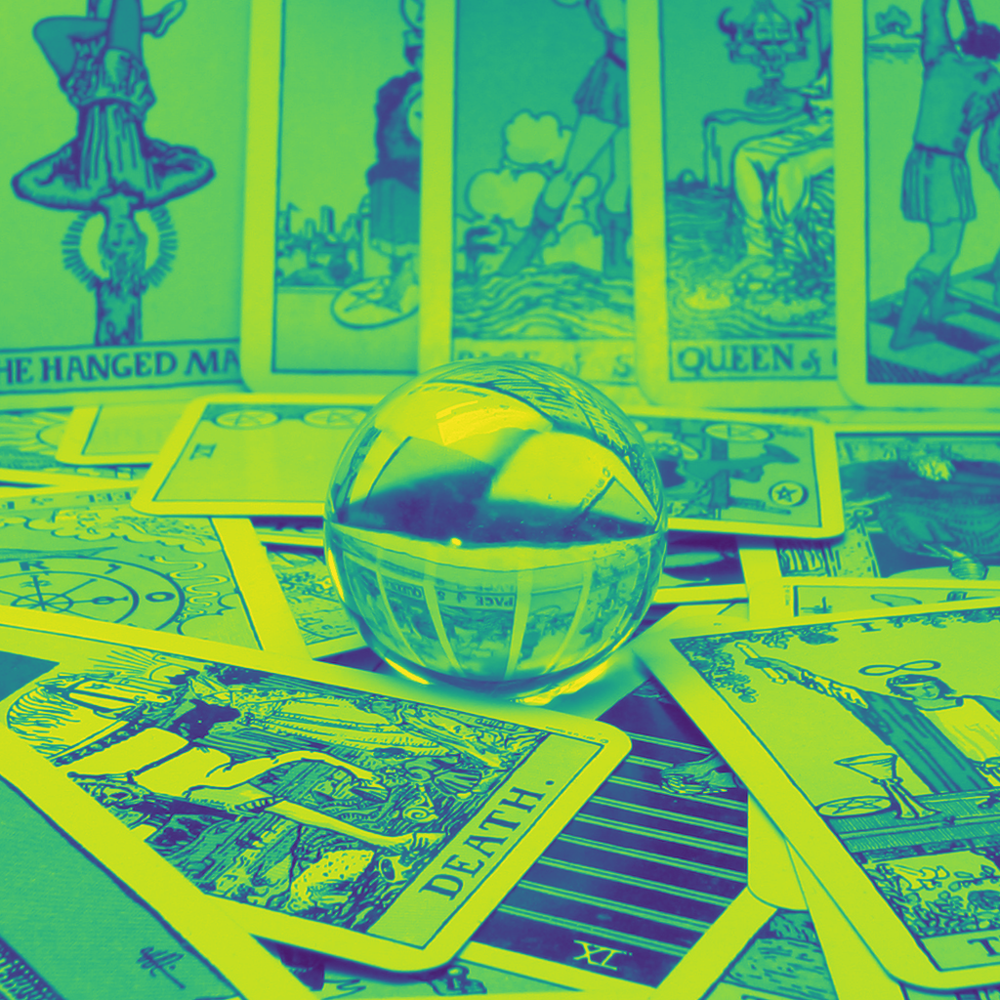

In [7]:
dataset_lf = np.zeros((17, 17, 1024, 1024))

dataset_path = "datasets/tarot/"
path_length = len(dataset_path)

for image_path in glob.glob(dataset_path + "*.png"):
    i_a = int(image_path[path_length+7:path_length+9])
    j_a = int(image_path[path_length+4:path_length+6])
    dataset_lf[i_a, j_a] = np.array(Image.open(image_path).convert('L').transpose(Image.ROTATE_270))

display_image(dataset_lf[8, 8])

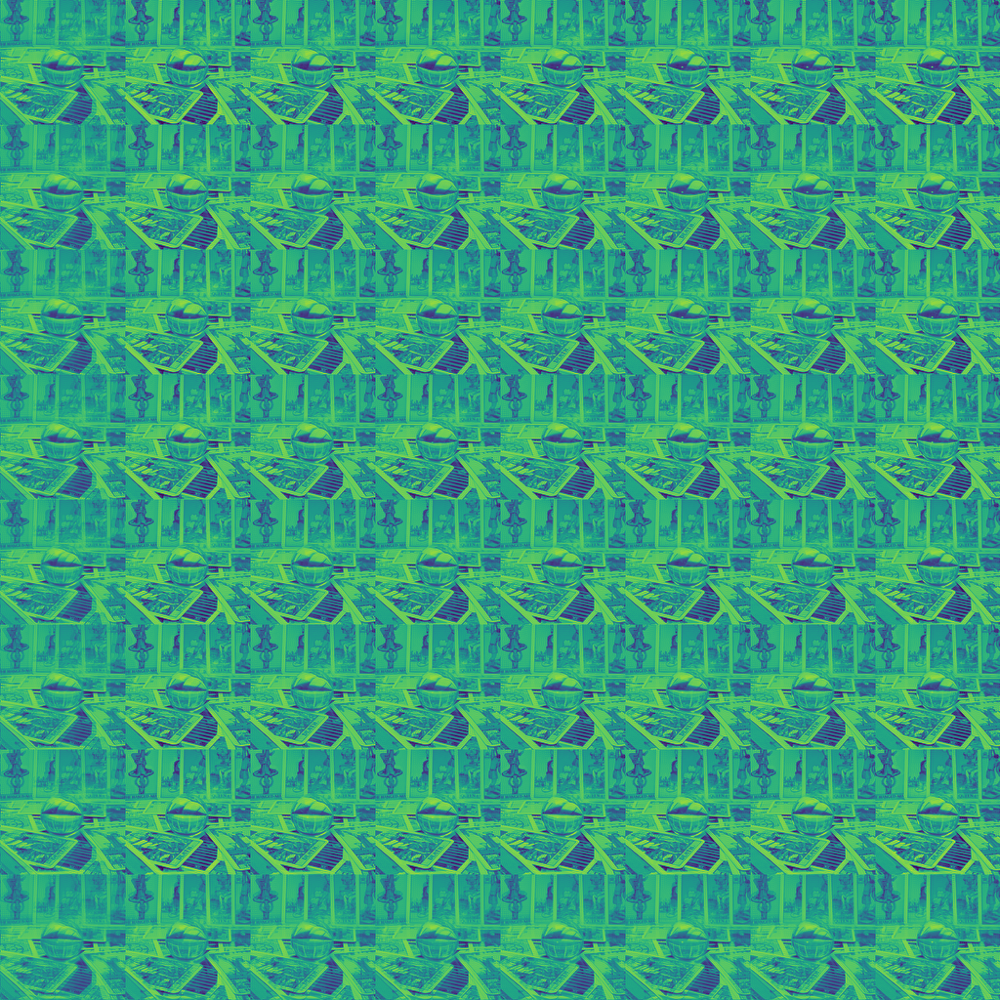

In [8]:
naive_lf = naive_downsampling(dataset_lf, low_res_a, low_res_b)
display_light_field(naive_lf)

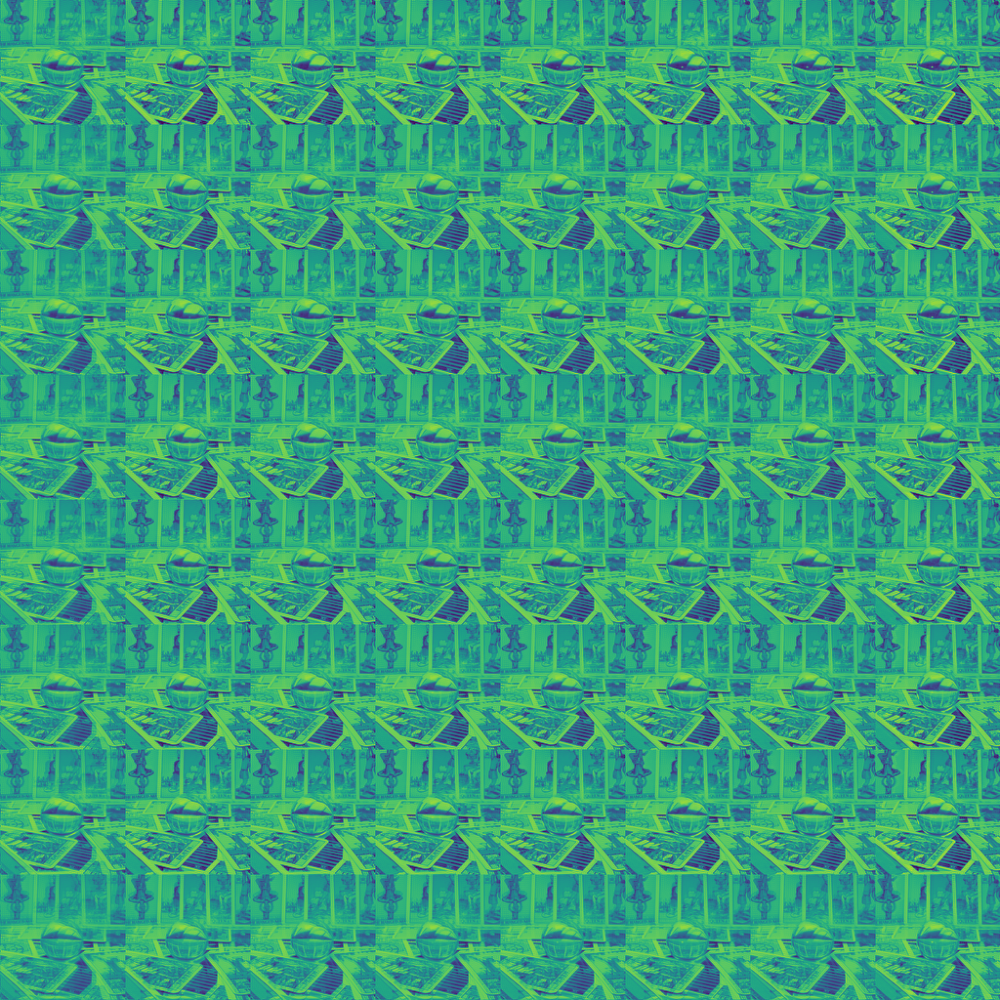

In [9]:
resampled_lf = dataset_lf
resampled_lf = signal.resample(resampled_lf, low_res_a, axis=0)
resampled_lf = signal.resample(resampled_lf, low_res_a, axis=1)
resampled_lf = signal.resample(resampled_lf, low_res_b, axis=2)
resampled_lf = signal.resample(resampled_lf, low_res_b, axis=3)
display_light_field(resampled_lf)

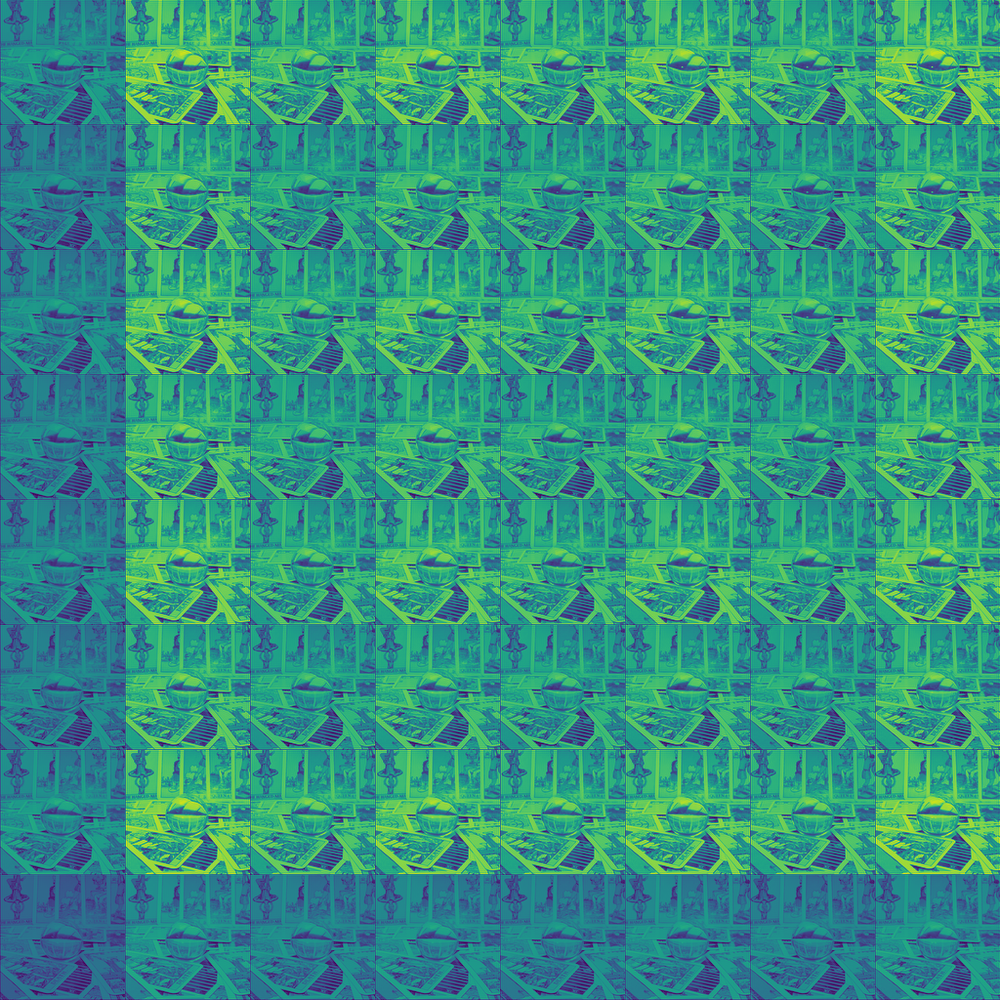

In [10]:
poly_lf = dataset_lf
poly_lf = signal.resample_poly(poly_lf, low_res_a, high_res_a, axis=0)
poly_lf = signal.resample_poly(poly_lf, low_res_a, high_res_a, axis=1)
poly_lf = signal.resample_poly(poly_lf, low_res_b, high_res_b, axis=2)
poly_lf = signal.resample_poly(poly_lf, low_res_b, high_res_b, axis=3)
display_light_field(poly_lf)


focus distance = 14.6


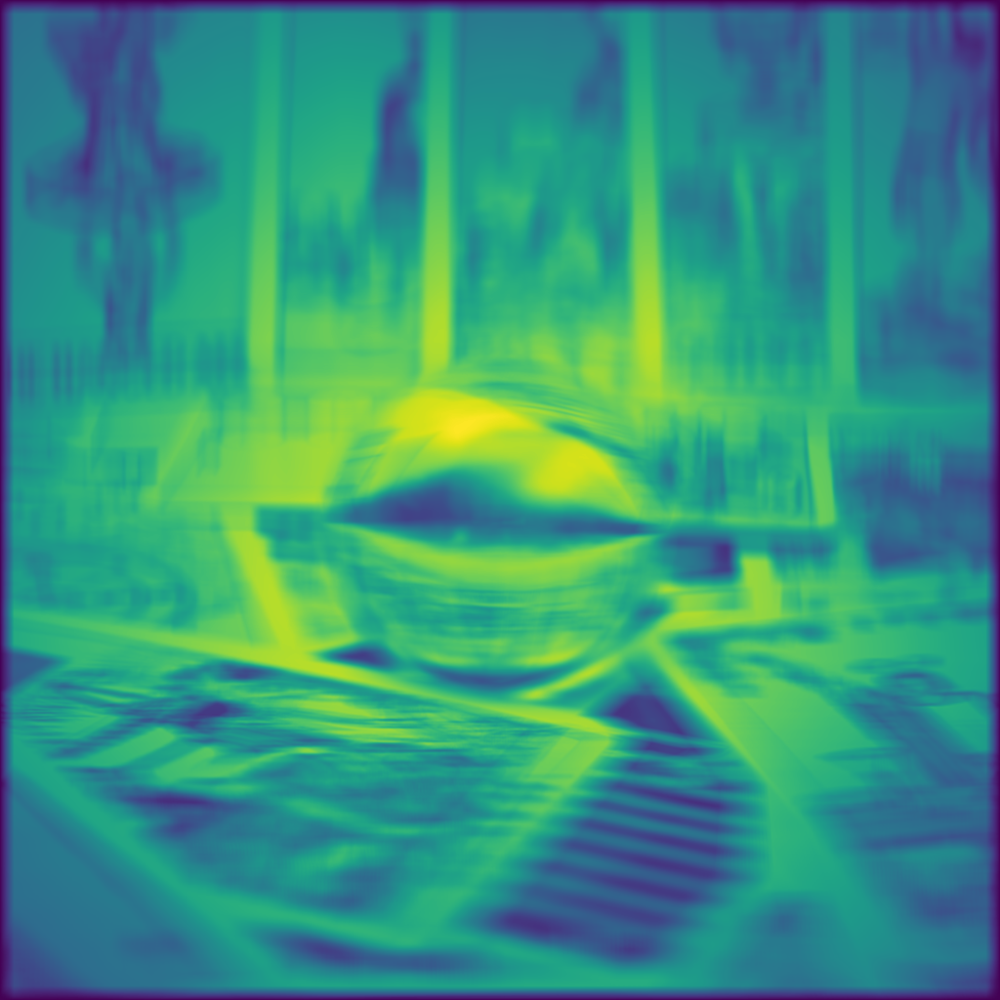


focus distance = 15.0


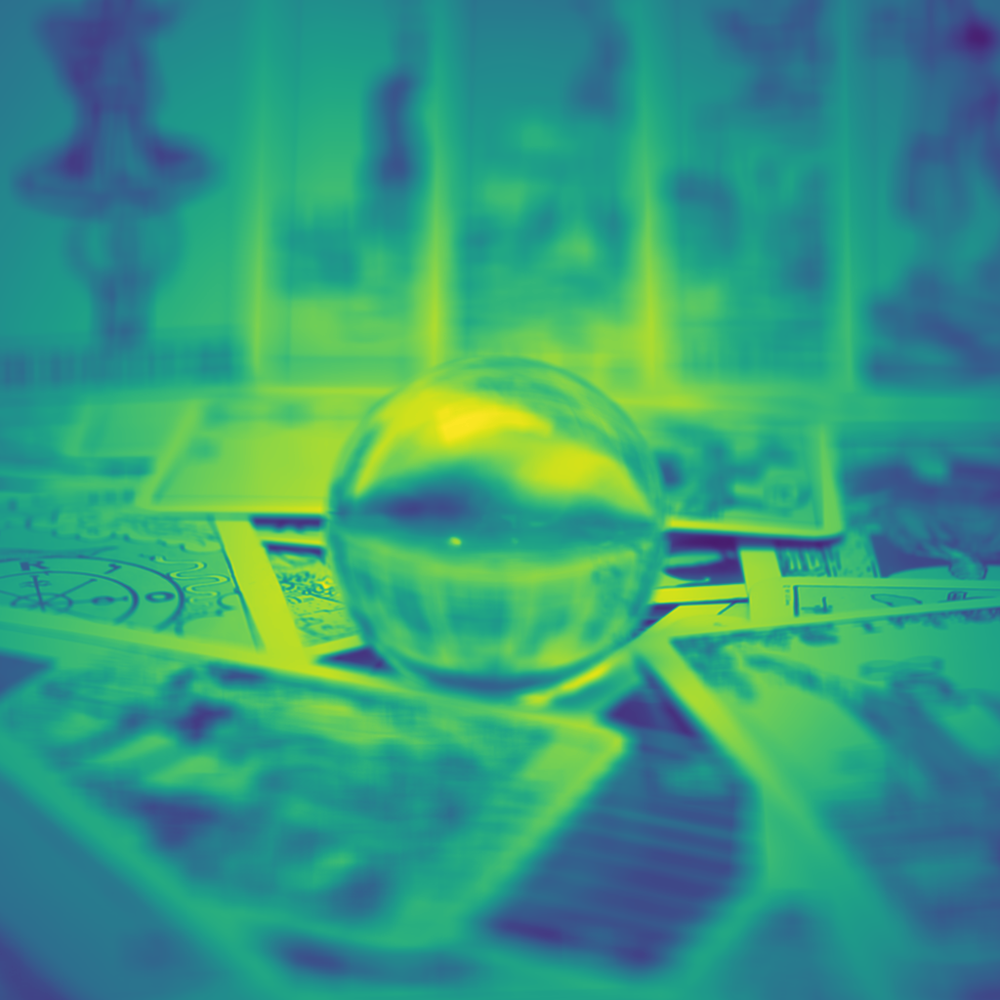


focus distance = 15.4


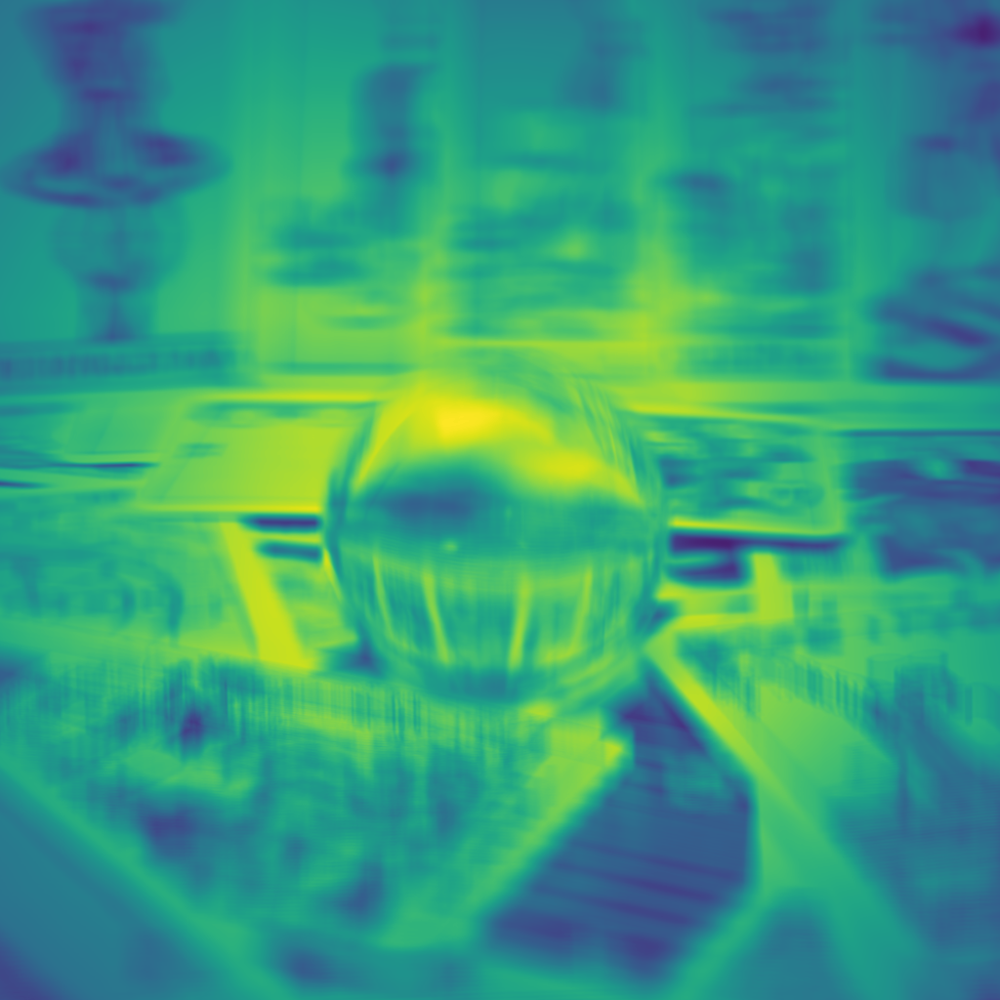


focus distance = 15.8


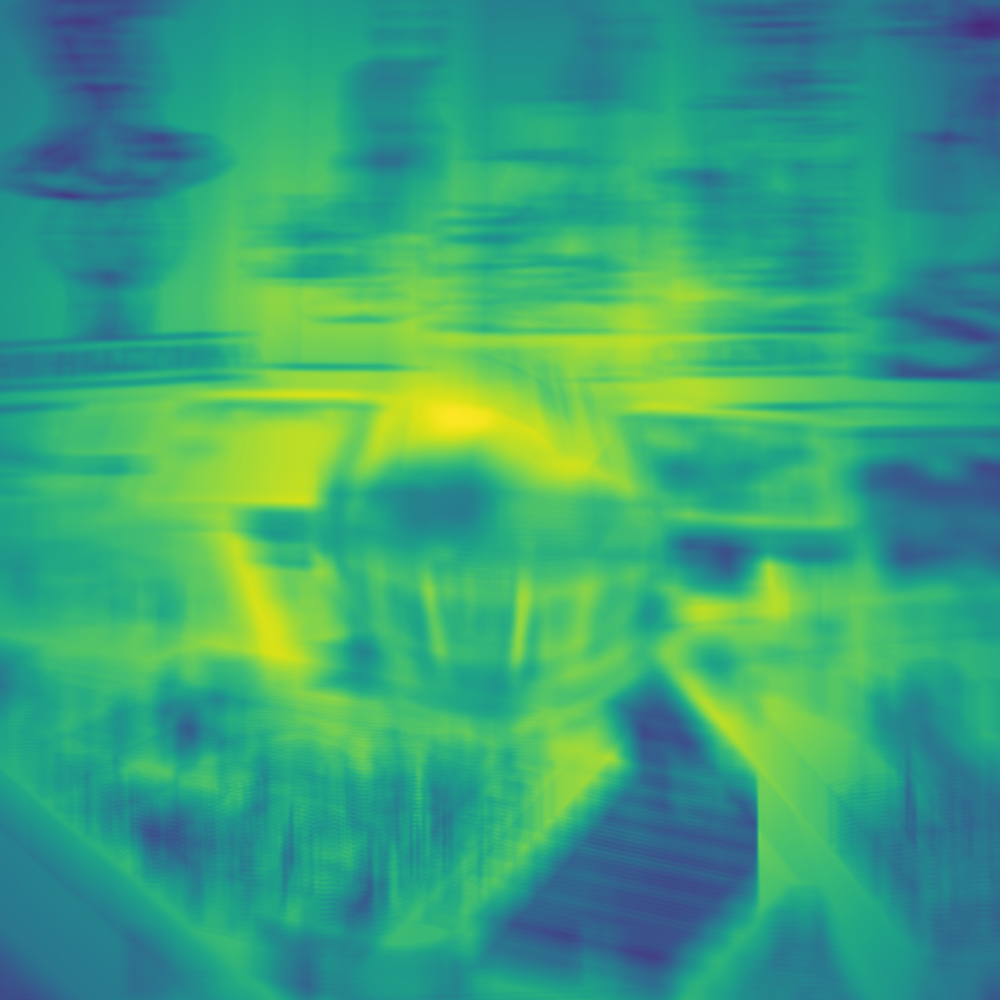

In [11]:
# Original dataset light field

for z_f in z_f_list:
    high_res_tensor = compute_imaging_tensor(res_r, high_res_a, high_res_b, z_r, z_a, z_b, z_f,
                                             size_r, size_a, size_b, pupil_diameter)
    high_res_image = apply_imaging_tensor(dataset_lf, high_res_tensor)
    print('\nfocus distance =', z_f)
    display_image(high_res_image)


focus distance = 14.6


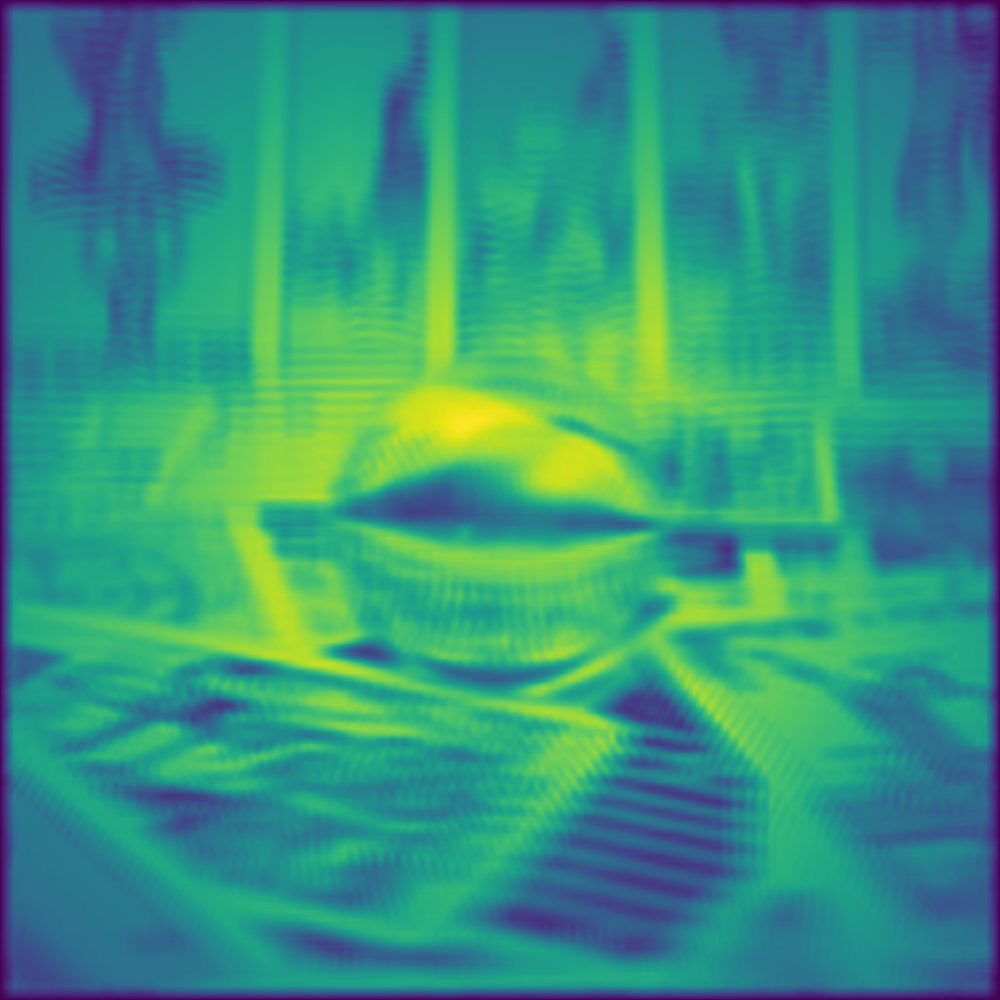


focus distance = 15.0


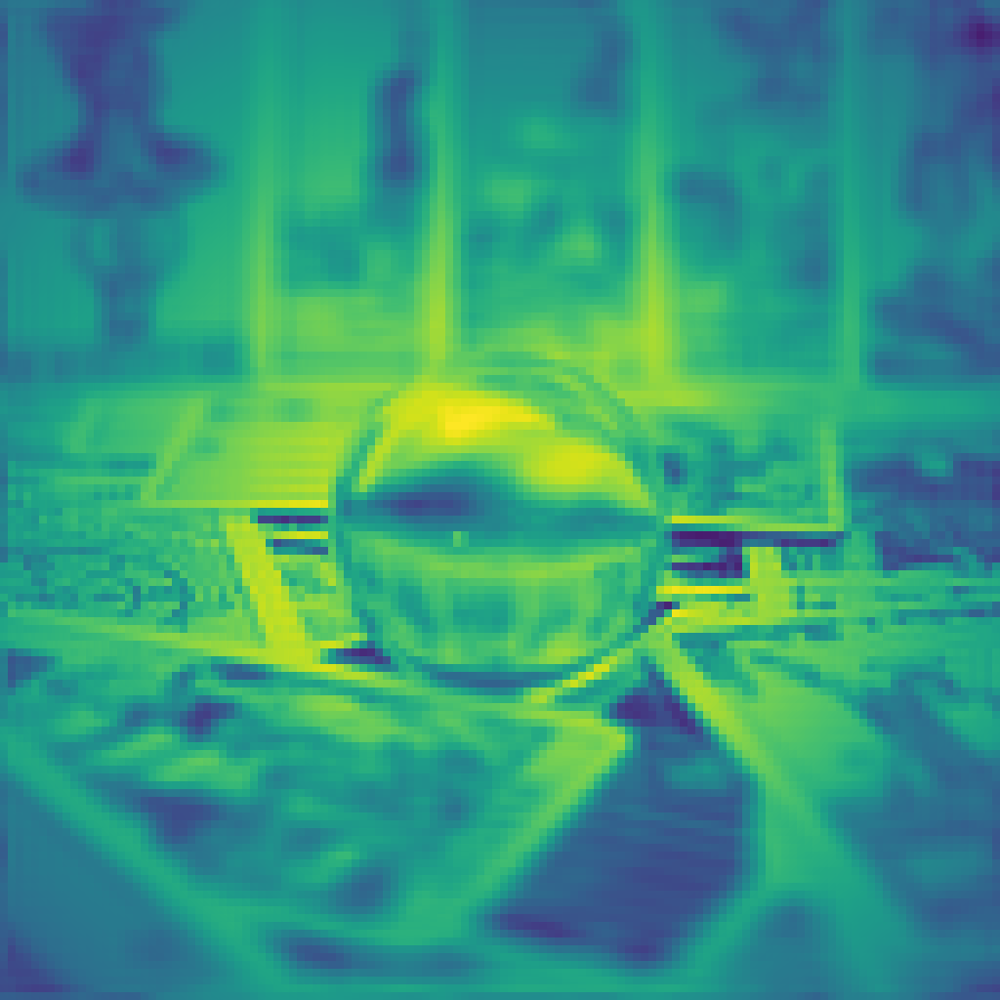


focus distance = 15.4


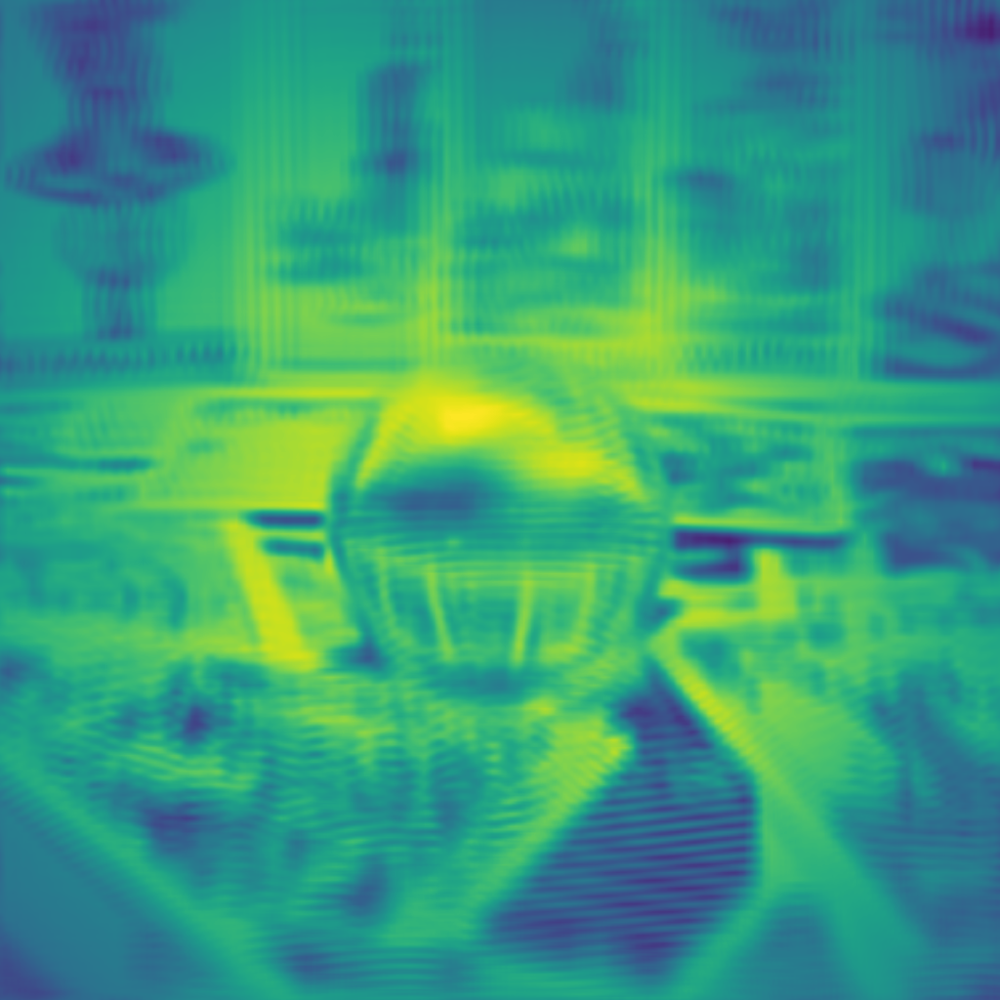


focus distance = 15.8


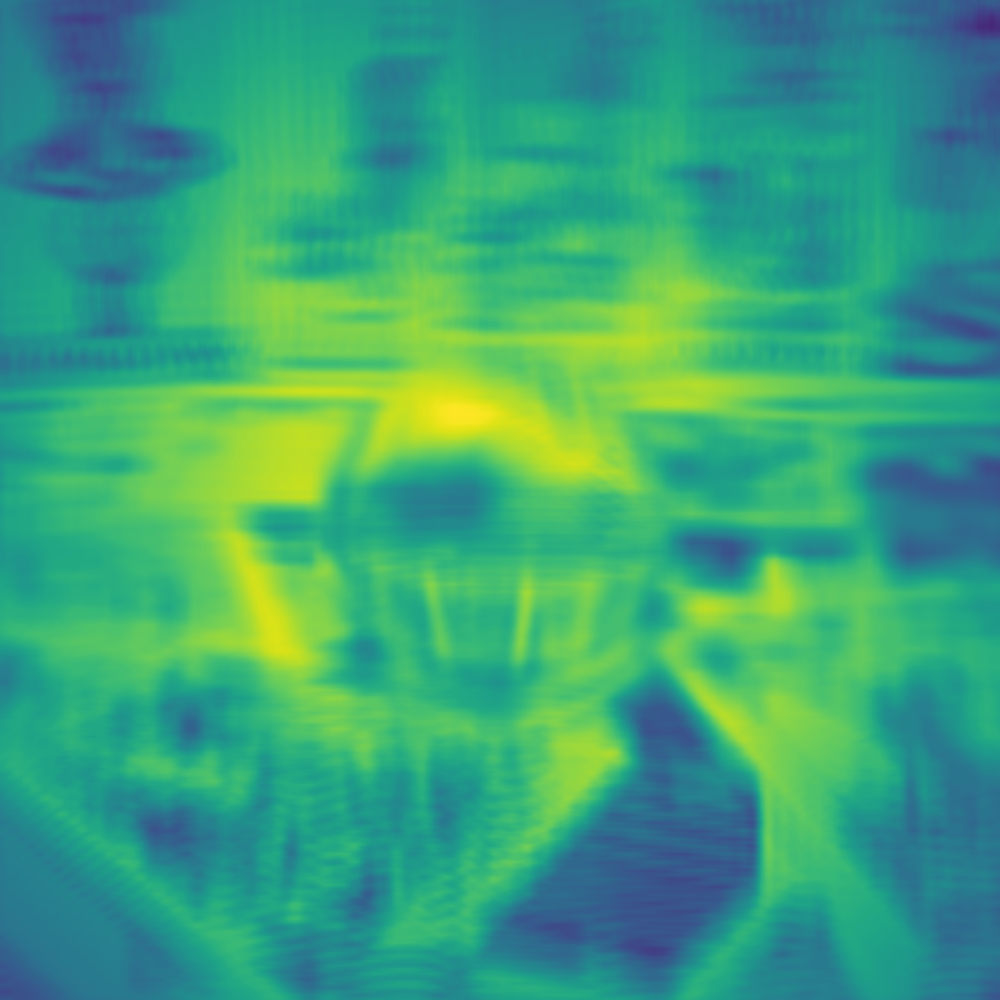

In [12]:
# Downsampled light field with naive method

for z_f in z_f_list:
    low_res_tensor = compute_imaging_tensor(res_r, low_res_a, low_res_b, z_r, z_a, z_b, z_f,
                                            size_r, size_a, size_b, pupil_diameter)
    low_res_image = apply_imaging_tensor(naive_lf, low_res_tensor)
    print('\nfocus distance =', z_f)
    display_image(low_res_image)


focus distance = 14.6


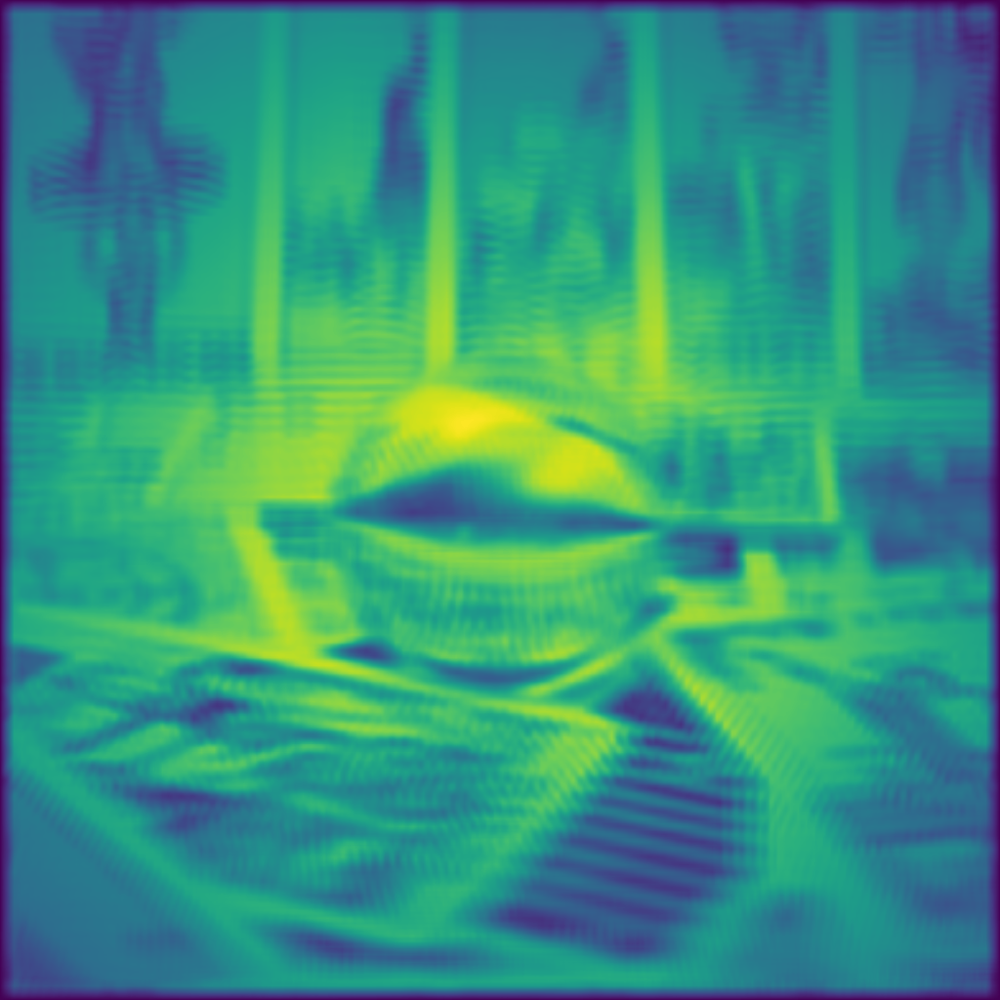


focus distance = 15.0


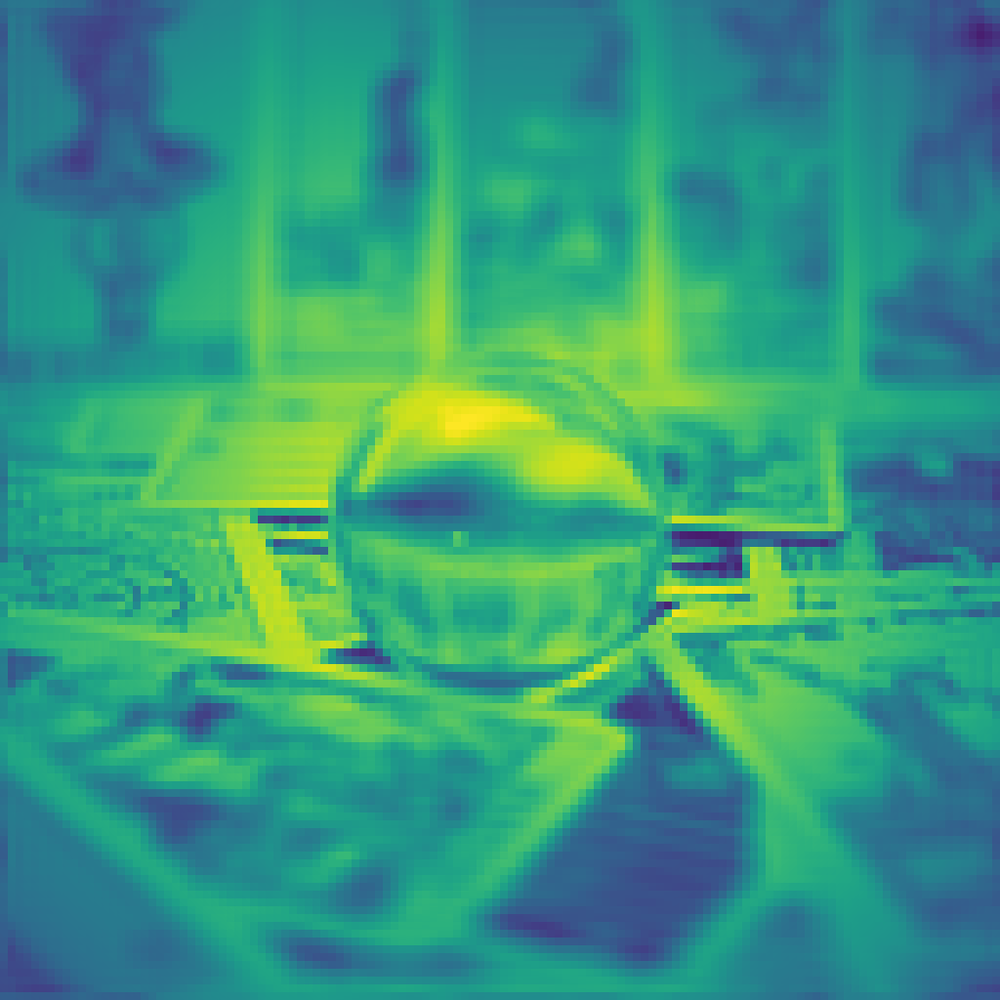


focus distance = 15.4


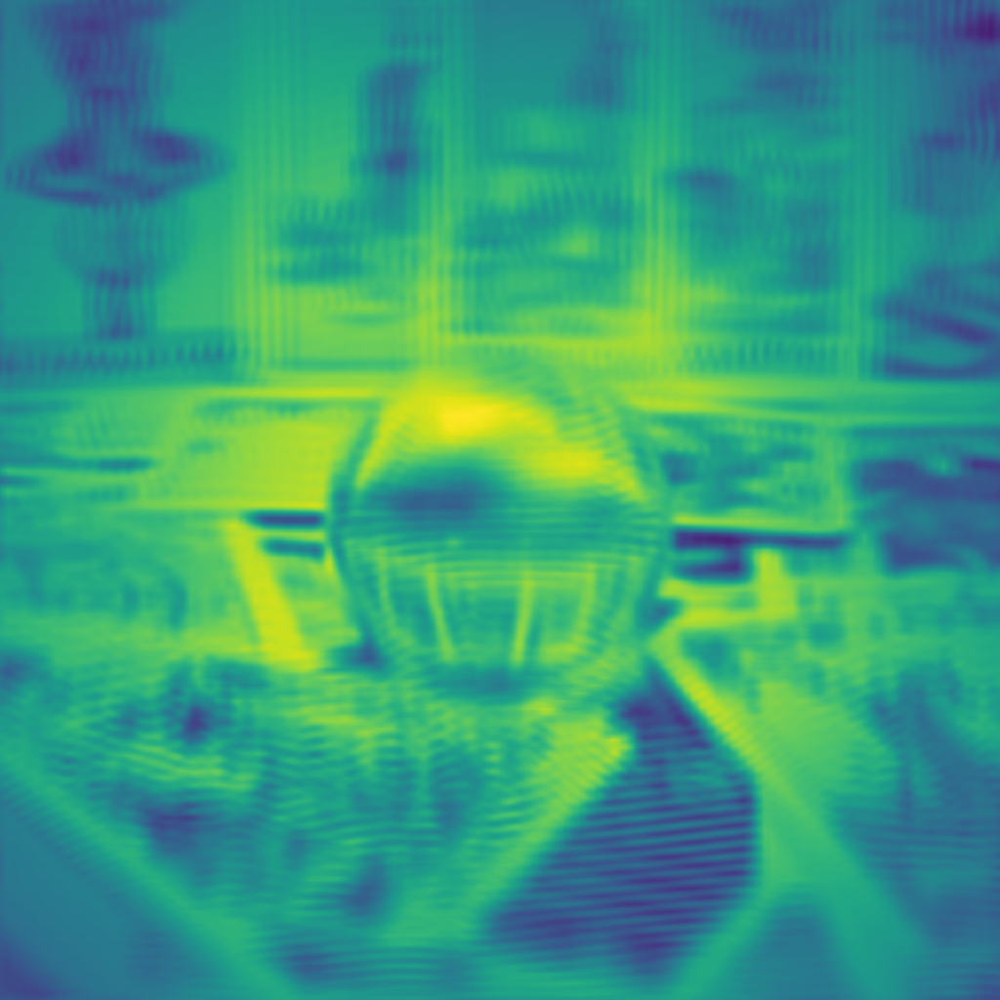


focus distance = 15.8


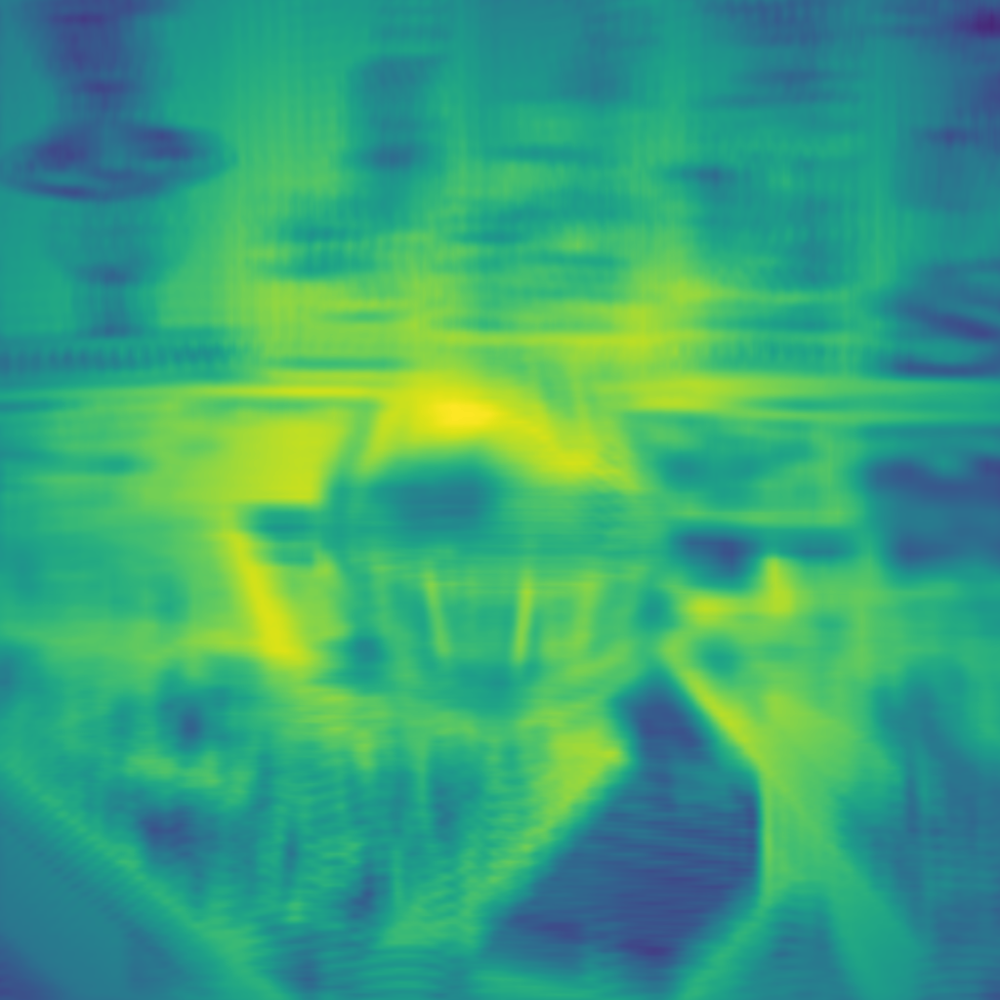

In [13]:
# Downsampled light field with scipy.signal.resample

for z_f in z_f_list:
    low_res_tensor = compute_imaging_tensor(res_r, low_res_a, low_res_b, z_r, z_a, z_b, z_f,
                                            size_r, size_a, size_b, pupil_diameter)
    low_res_image = apply_imaging_tensor(resampled_lf, low_res_tensor)
    print('\nfocus distance =', z_f)
    display_image(low_res_image)


focus distance = 14.6


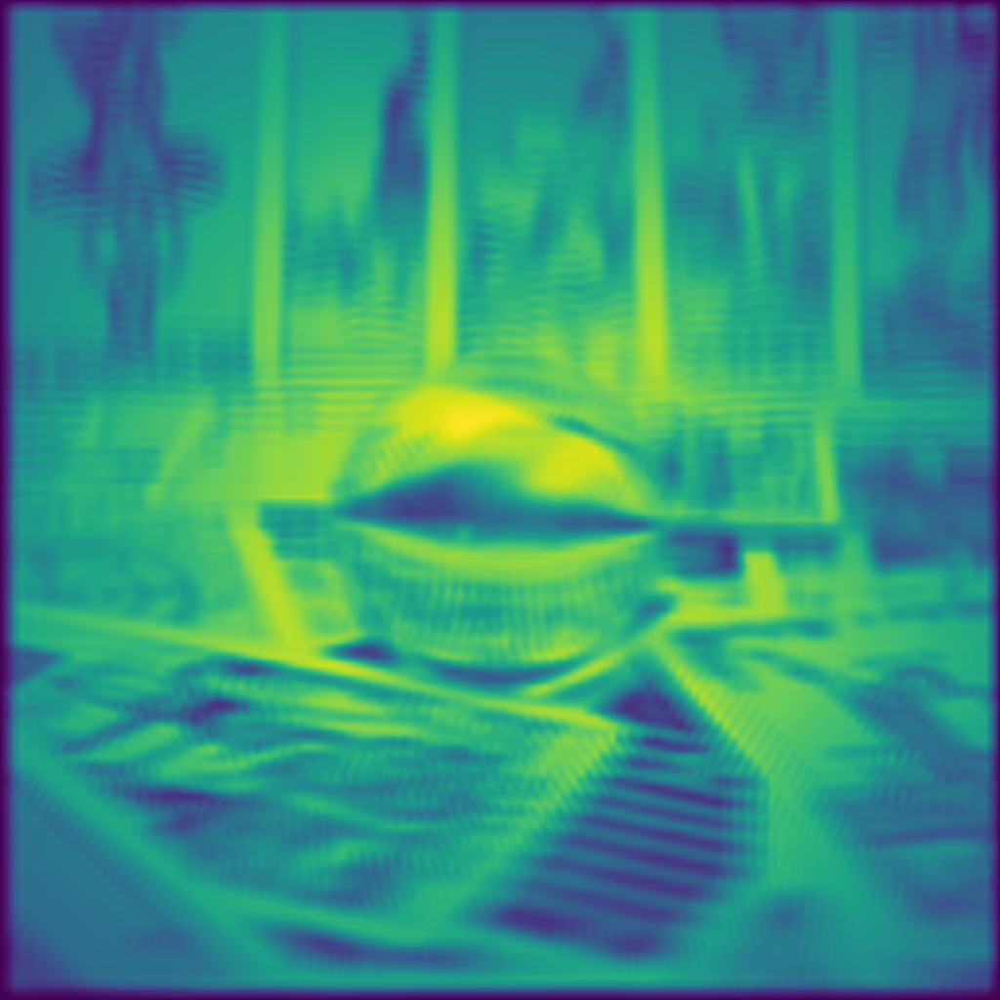


focus distance = 15.0


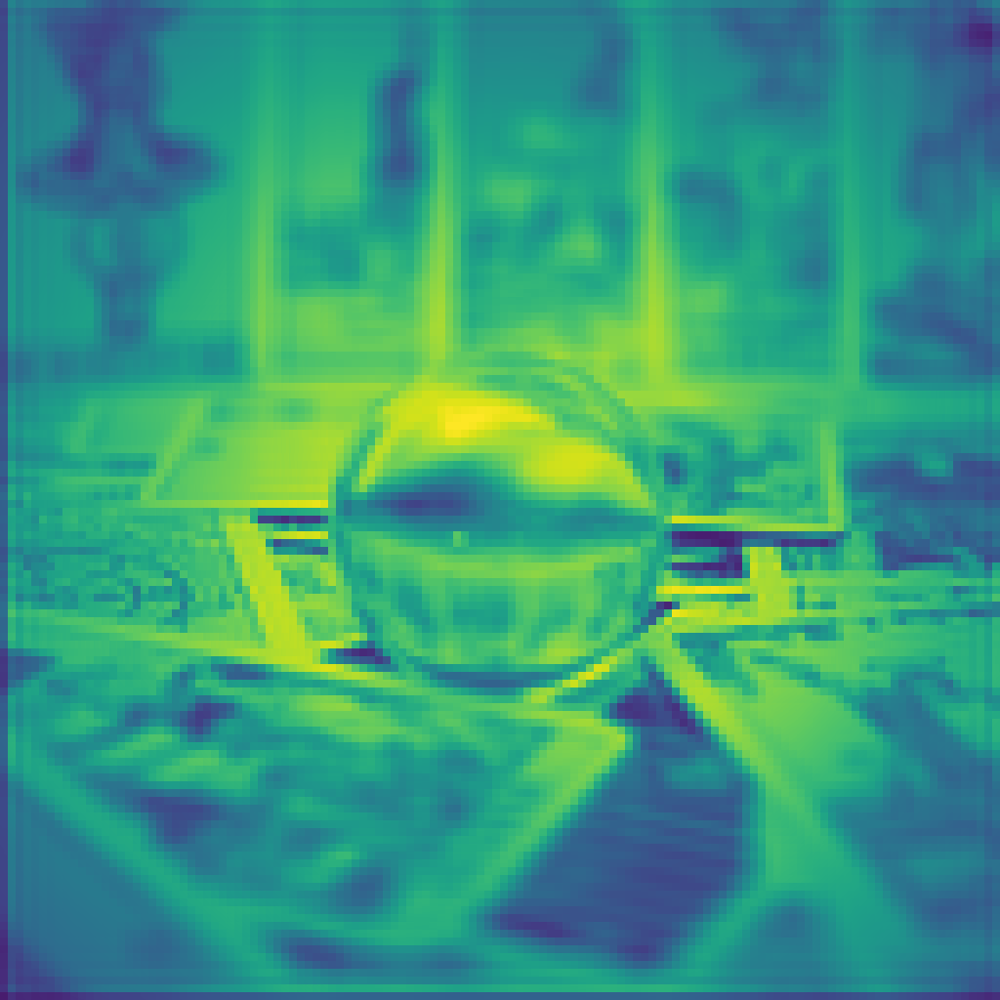


focus distance = 15.4


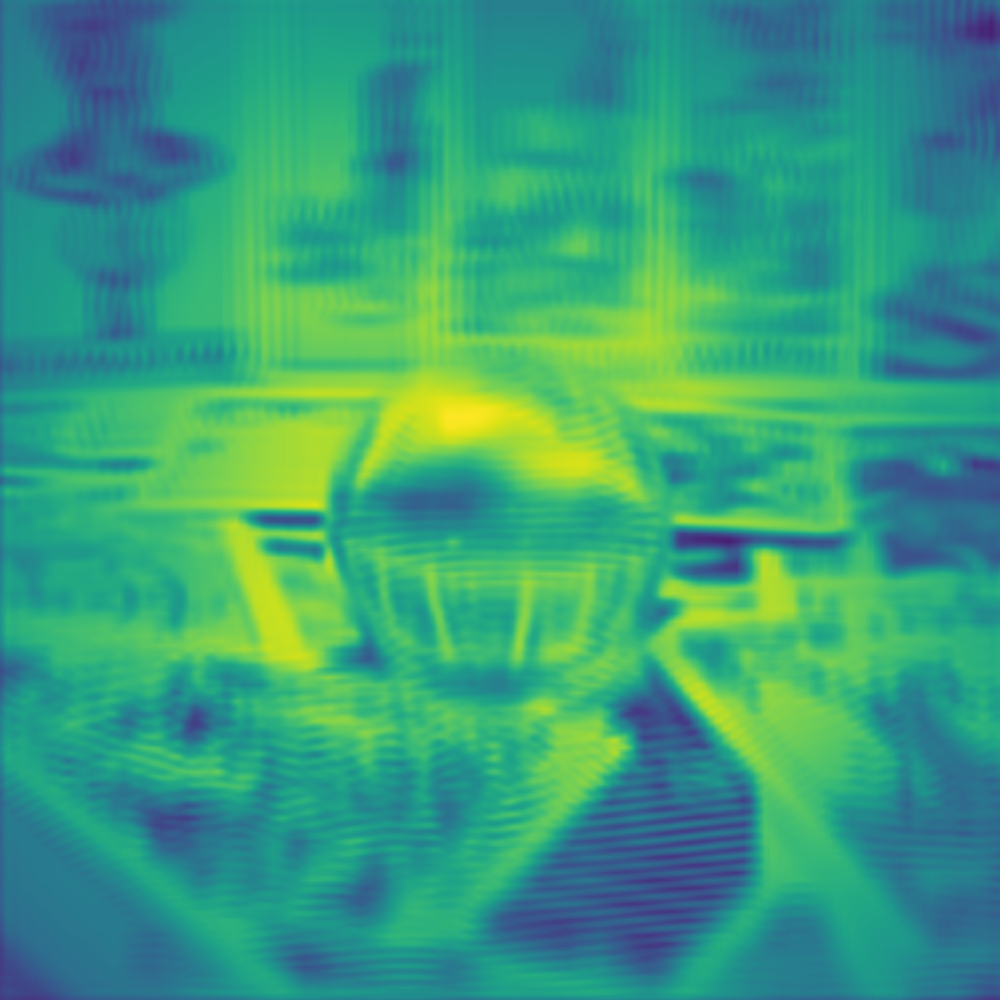


focus distance = 15.8


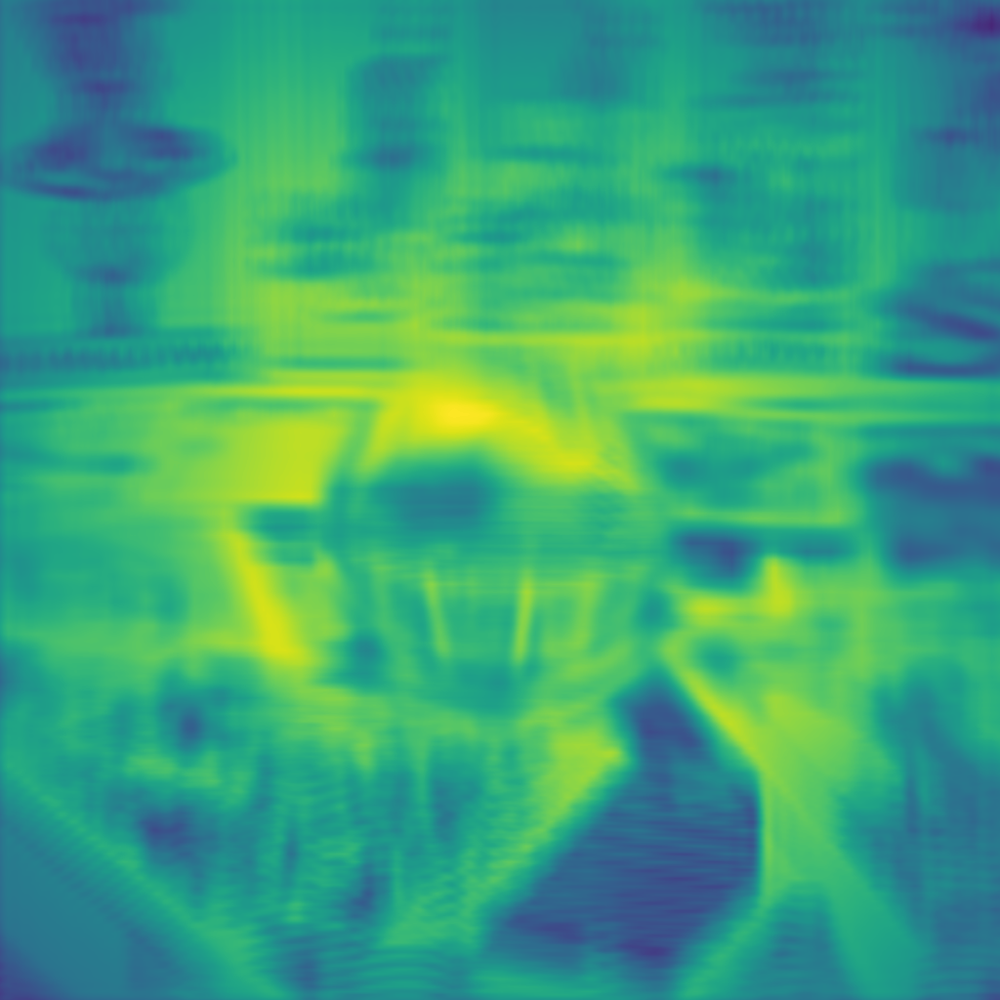

In [14]:
# Downsampled light field with scipy.signal.resample_poly

for z_f in z_f_list:
    low_res_tensor = compute_imaging_tensor(res_r, low_res_a, low_res_b, z_r, z_a, z_b, z_f,
                                            size_r, size_a, size_b, pupil_diameter)
    low_res_image = apply_imaging_tensor(poly_lf, low_res_tensor)
    print('\nfocus distance =', z_f)
    display_image(low_res_image)